## **função para extrair as métricas e facilitar**

In [33]:
def resumo(Ref_cal, Pred_cal, Ref_val, Pred_val):
    """
    Função para calcular as métricas de desempenho do modelo de regressão linear.
    Args:
        Ref_cal (array): Valores reais de calibração.
        Pred_cal (array): Valores previstos de calibração.
        Ref_val (array): Valores reais de validação.
        Pred_val (array): Valores previstos de validação.
    Returns:
        pd.DataFrame: DataFrame com as métricas de desempenho.
    """
    import pandas as pd
    import numpy as np
    from sklearn.metrics import mean_squared_error, r2_score
    from scipy.stats import iqr


    # Calculando R²
    R2_cal = r2_score(Ref_cal, Pred_cal)
    R2_val = r2_score(Ref_val, Pred_val)

    # Calculando RMMSE
    rmsec = np.sqrt(mean_squared_error(Ref_cal, Pred_cal))
    rmsep = np.sqrt(mean_squared_error(Ref_val, Pred_val))

    #Calculando rpd
    rpd = np.std(Ref_cal)/rmsep

    #Calculando RPIQ
    rpiq = iqr(Ref_val, rng=(25,75))/rmsep

    # Calculando Bias
    bias_pred = sum(Ref_val - Pred_val) / len(Pred_val)

    # Resumo do modelo
    resumo = pd.DataFrame([R2_cal, R2_val, rmsec, rmsep, rpd, rpiq, bias_pred]).T
    resumo.columns = ['R2_cal', 'R2_pred', 'RMSEC', 'RMSEP','RPD', 'RPIQ', 'Bias_pred']
    return resumo.round(3)

## **importando dados .csv com o pandas.read_csv**

In [34]:
import pandas as pd 
Dataset = pd.read_csv('Dataset.csv', header=0, sep=';') #importando os dados

In [35]:
Atributos = Dataset.loc[:, ['SOC', 'CEC', 'pH', 'exMg', 'exP', 'exK', 'exCa']] #extraindo os atributos
Atributos.head(n=10) # mostra as 5 primeiras linhas do dataframe Y

,SOC,CEC,pH,exMg,exP,exK,exCa
0,18.89,11.90,5.2,1.68,24.2,0.56,4.32
1,16.24,11.76,5.6,2.01,12.1,0.38,5.10
2,23.18,13.28,5.5,2.30,17.7,0.20,5.82
3,14.64,10.71,5.2,1.60,5.5,0.10,3.67
4,22.98,13.13,4.6,1.48,21.6,0.30,3.60
5,15.38,11.15,4.4,0.94,11.8,0.14,2.87
6,26.72,14.59,5.4,2.96,27.2,0.35,6.32
7,14.99,11.59,4.9,1.93,9.7,0.10,3.80
8,23.41,14.09,4.7,2.17,39.9,0.30,4.42
9,14.84,12.10,4.5,1.43,9.0,0.12,3.35


## **kennard-stone**

In [36]:
# dividindo os dados via kennard-stone (mais recomendado)
import kennard_stone as ks

Ycal, Yval = ks.train_test_split(Atributos, test_size=0.3) # divide o dataframe Y em 70% para treino e 30% para teste

C:\Users\Usuario\AppData\Roaming\Python\Python313\site-packages\sklearn\utils\deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.

2025-04-29 14:07:05,916 - kennard_stone.utils._pairwise:109[INFO] - Calculating pairwise distances using scikit-learn.

C:\Users\Usuario\AppData\Roaming\Python\Python313\site-packages\sklearn\utils\deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.

2025-04-29 14:07:05,933 - kennard_stone.utils._pairwise:109[INFO] - Calculating pairwise distances using scikit-learn.

C:\Users\Usuario\AppData\Roaming\Python\Python313\site-packages\sklearn\utils\deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



In [37]:
# antes de começar, vamos utilizar os dados espectrais (com muitas variaveis) para fazer uma regressão PLS
pd.options.plotting.backend = 'plotly'

XRF = Dataset.loc[:,'1':'15']
XRF.T.plot()

In [38]:
# vamos utilizar a mesma separação de dados gerada no KS anterior para separar os espectros cal e val

XRFcal = XRF.loc[Ycal.index, :] # seleciona as linhas correspondentes as amostras de calibração
XRFval = XRF.loc[Yval.index, :] # seleciona os dados de validação

#A principal diferença entre .iloc e .loc em Python reside no método de seleção de dados. 
# .iloc seleciona dados por posição (índice inteiro) das linhas e colunas, enquanto .loc seleciona dados por rótulos (nomes) das linhas e colunas. 

In [39]:
# vamos pre-processar os dados com poisson scale + mean centering
import preprocessings as prepr
import numpy as np

XRFcal_prep, meanXRF, meanpoisson = prepr.poisson(XRFcal, mc=True) # aplica o preprocessamento 
XRFval_prep = (XRFval / np.sqrt(meanXRF)) - meanpoisson # aplica o mesmo preprocessamento nos dados de validação
XRFcal_prep.T.plot()

# **Random Forest**

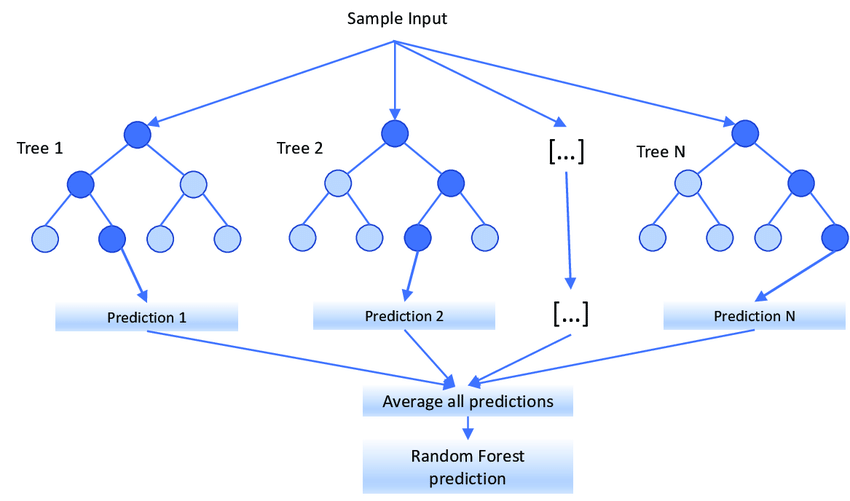

# **Aplicação do algoritmo RandomForest** <br>

**sklearn.ensemble.RandomForestRegressor**(**n_estimators**=100, *, **criterion**='squared_error', **max_depth**=None, **min_samples_split**=2, **min_samples_leaf**=1, **min_weight_fraction_leaf**=0.0, **max_features**=1.0, **max_leaf_nodes**=None, **min_impurity_decrease**=0.0, **bootstrap**=True, **oob_score**=False, **n_jobs**=None, **random_state**=None, **verbos**e=0, **warm_start**=False, **ccp_alpha**=0.0, **max_samples**=None, **monotonic_cst**=None)

**Parâmetros**: <br>
- **criterion** (strg): A função para medir a qualidade de uma divisão. {“squared_error”, “absolute_error”, “friedman_mse”, “poisson”}, padrão=”squared_error” <br>
- **n_estimators** (int): número de árvores na floresta (default = 100)<br>
- **min_samples_split** (int): O número mínimo de amostras necessárias para dividir um nó teste default=2 <br>
- **max_features** (int): número máximo de recursos (**variáveis**) considerados para dividir um nó default=1.0 (todas as features) <br>
- **max_depth** (int/float): número máximo de níveis em cada árvore de decisão default=None <br>
- **min_samples_leaf** (int): O número mínimo de amostras necessárias para estar em um nó folha default=1 <br>
- **min_impurity_decrease** (float): Um nó será dividido se esta divisão induzir uma diminuição da impureza maior ou igual a este valor.<br>
- **random_state**: semente usada para gerar números aleatórios durante a execução (importante para reprodutibilidade)
<br>
Para os outros parametros, ver: <br>
Ver: https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestRegressor.html

In [ ]:
#modelando com random forest
from sklearn.ensemble import RandomForestRegressor

# Criando a função classe RandomForestRegressor() com parametros no default
rf = RandomForestRegressor(criterion='squared_error', # critério de erro
                           random_state=1) #a semente é para garantir a reprodutibilidade dos resultados

# Ajustando o algoritmo a base de dados
rf.fit(XRFcal_prep, Ycal['exCa'])

# Resultados de calibração e predição por meio do comando predict()
predicoes_rf_cal = rf.predict(XRFcal_prep)
calres_rf = pd.DataFrame({'Ref': Ycal['exCa'], 'Pred':predicoes_rf_cal})

# resultados de validação
predicoes_rf_val = rf.predict(XRFval_prep)
predres_rf = pd.DataFrame({'Ref': Yval['exCa'], 'Pred':predicoes_rf_val})

In [50]:
resultados_rf = pd.concat([calres_rf, predres_rf], axis=0).reset_index(drop=True) # junta os dataframes de calibração e validação
resultados_rf.insert(0, 'Grupo', ['Cal'] * len(Ycal) + ['Val'] * len(Yval)) # insere uma coluna com o grupo (calibração ou validação) no dataframe de previsões

In [46]:
import plotly.express as px
#plot de dispersão
fig = px.scatter(resultados_rf,
                 x='Ref',
                 y='Pred',
                 color='Grupo',
                 color_discrete_sequence=['red', 'blue'])
fig.show()

In [41]:
resultados_rf['Residuo'] = resultados_rf['Ref'] - resultados_rf['Pred'] # calcula o erro entre a referência e a previsão
resultados_rf['Residuo'].mean() # calcula a média dos resíduos

np.float64(-0.03050483870967829)

In [42]:
fig = px.scatter(resultados_rf,
                 x='Ref',
                 y='Residuo',
                 color='Grupo',
                 color_discrete_sequence=['red', 'blue']) # cria um gráfico de dispersão dos resíduos
fig.show() # mostra o gráfico

In [51]:
# extraindo metricas de desempenho do modelo
resumo_rf = resumo(calres_rf['Ref'], calres_rf['Pred'], predres_rf['Ref'], predres_rf['Pred']).T # calcula o resumo para os dados de calibração
resumo_rf

,0
R2_cal,0.971
R2_pred,0.834
RMSEC,0.325
RMSEP,0.771
RPD,2.480
RPIQ,3.880
Bias_pred,-0.098


In [ ]:
#tunando a rede com grades de pesquisa
from sklearn.model_selection import RandomizedSearchCV

param_grid = { 
    'n_estimators': [40, 60, 80], #numero de arvores (default = 100)
    'max_features': [0.4, 0.6, 0.8], #numero maximo de variaveis consideradas para dividir um nó (default =1.0)
    'max_depth': [5, 10, 15], #maximo nivel considerado em uma arvore (default = None)
    'max_leaf_nodes': [5, 10, 15], #maximo de amostras nos nós folha (default = None)
} 

rf_tuned = RandomizedSearchCV(estimator = RandomForestRegressor(criterion='squared_error', random_state=1), 
                              param_distributions = param_grid, #parametros a serem testados
                              scoring='neg_root_mean_squared_error', # métrica de erro a ser minimizada
                              n_iter = 50, # numero de combinações a serem testadas
                              cv = 10, # numero de subconjuntos para cross-validation
                              random_state=1, 
                              n_jobs = -1, # utiliza todos os processadores disponíveis
                              verbose = 2) # imprime o progresso do ajuste

#usando os melhores parametros
rf_tuned.fit(XRFcal_prep, Ycal['exCa']) # ajusta o modelo com os dados de calibração
best_params = rf_tuned.best_params_

#printando os resultados
print('Melhor modelo: ', rf_tuned.best_estimator_, '\n')
print ('Melhores parâmetros: ', rf_tuned.best_params_, '\n')
print('Menor RMSECV: ', -rf_tuned.best_score_)
# demorou 6 min

Fitting 10 folds for each of 50 candidates, totalling 500 fits
Melhor modelo:  RandomForestRegressor(max_depth=10, max_features=0.8, max_leaf_nodes=15,
                      n_estimators=80, random_state=1) 

Melhores parâmetros:  {'n_estimators': 80, 'max_leaf_nodes': 15, 'max_features': 0.8, 'max_depth': 10} 

Menor RMSECV:  0.8550335684538366


In [52]:
best_rf = RandomForestRegressor(**best_params, criterion='squared_error', random_state=1) # fitando o modelo com as melhores condições
best_rf.fit(XRFcal_prep, Ycal['exCa'])
predicoes_rf_tuned_cal = best_rf.predict(XRFcal_prep) # faz previsões com o modelo tunado
calres_rf_tuned = pd.DataFrame({'Ref': Ycal['exCa'], 'Pred':predicoes_rf_tuned_cal}) # cria um dataframe com as previsões
predicoes_rf_tuned_val = best_rf.predict(XRFval_prep) # faz previsões com o modelo tunado
predres_rf_tuned = pd.DataFrame({'Ref': Yval['exCa'], 'Pred':predicoes_rf_tuned_val}) # cria um dataframe com as previsões
#também podemos usar o comando rf_tuned.best_estimator para fazer o .predict (nao precisa usar o .fit dai)


In [53]:
resultados_rf_tuned = pd.concat([calres_rf_tuned, predres_rf_tuned], axis=0).reset_index(drop=True) # junta os dataframes de calibração e validação
resultados_rf_tuned.insert(0, 'Grupo', ['Cal'] * len(Ycal) + ['Val'] * len(Yval)) # insere uma coluna com o grupo (calibração ou validação) no dataframe de previsões
resumo_rf_tuned = resumo(calres_rf_tuned['Ref'], calres_rf_tuned['Pred'], predres_rf_tuned['Ref'], predres_rf_tuned['Pred']).T # calcula o resumo para os dados de calibração
resumo_rf_tuned # mostra o resumo do modelo tunado

,0
R2_cal,0.892
R2_pred,0.827
RMSEC,0.628
RMSEP,0.788
RPD,2.426
RPIQ,3.795
Bias_pred,-0.077


In [54]:
#dispersão do modelo tunado
fig = px.scatter(resultados_rf_tuned,
                 x='Ref',
                 y='Pred',
                 color='Grupo',
                 color_discrete_sequence=['red', 'blue'])
fig.show() # mostra o gráfico

In [18]:
# resultados da cross-validation

# Converter os resultados da validação cruzada para um DataFrame
cv_results = pd.DataFrame(rf_tuned.cv_results_)

# Exibir os primeiros 5 resultados
cv_results.head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_estimators,param_max_leaf_nodes,param_max_features,param_max_depth,params,split0_test_score,...,split3_test_score,split4_test_score,split5_test_score,split6_test_score,split7_test_score,split8_test_score,split9_test_score,mean_test_score,std_test_score,rank_test_score
0,3.716670,0.201255,0.017334,0.002596,40,5,0.6,15,"{'n_estimators': 40, 'max_leaf_nodes': 5, 'max...",-1.017160,...,-0.929948,-0.823516,-0.912531,-0.973987,-0.946974,-0.892068,-1.400189,-0.971960,0.151313,42
1,2.551145,0.142695,0.016049,0.003130,40,5,0.4,10,"{'n_estimators': 40, 'max_leaf_nodes': 5, 'max...",-1.017885,...,-0.914972,-0.849393,-0.930581,-0.986899,-0.950830,-0.909072,-1.410996,-0.980165,0.150814,48
2,5.095796,0.242804,0.019868,0.003598,60,10,0.4,10,"{'n_estimators': 60, 'max_leaf_nodes': 10, 'ma...",-0.896084,...,-0.848888,-0.753504,-0.835011,-0.906201,-0.829531,-0.906933,-1.302687,-0.890640,0.145650,30
3,5.710295,0.304805,0.015467,0.002137,40,15,0.6,15,"{'n_estimators': 40, 'max_leaf_nodes': 15, 'ma...",-0.880760,...,-0.818493,-0.723057,-0.797139,-0.865988,-0.795812,-0.874119,-1.253608,-0.864229,0.137182,18
4,7.453345,0.290093,0.018826,0.001774,60,5,0.8,10,"{'n_estimators': 60, 'max_leaf_nodes': 5, 'max...",-1.001246,...,-0.929081,-0.823622,-0.921107,-0.980560,-0.949143,-0.901747,-1.399387,-0.972317,0.150230,44


In [60]:
#extraindo essas quantitades pelo feature_importances_
mdi_importances = pd.DataFrame({'importance': best_rf.feature_importances_, 
                                 'energia': XRFcal.columns})
mdi_importances['energia'] = pd.to_numeric(mdi_importances['energia'])
mdi_importances = mdi_importances.sort_values(by='energia', ascending=True)
mdi_importances.head(n=10)

#se usarmos os resultados diretamente da grade, podemos extrair por rf_tuned.best_estimator_.feature_importances_

,importance,energia
0,0.000110,1.00
1,0.000000,1.02
2,0.000000,1.04
3,0.000979,1.06
4,0.000093,1.08
5,0.000341,1.10
6,0.000000,1.12
7,0.000000,1.14
8,0.000000,1.16
9,0.000090,1.18


In [61]:
# plotando as variaveis importantes

fig = px.line(mdi_importances,
                 x='energia',
                 y='importance',
                 hover_data = 'energia',
                 title='Random Forest Feature Importance',
                 labels={'importance':'Importância', 'energia':'Energia (KeV)'},
                 color_discrete_sequence=['red']) # cria um gráfico de dispersão dos resíduos
fig.show() # mostra o gráfico

## **stacked generalization**

In [65]:
# vamos empilhar o modelo PLS da aula anterior com o RF de agora para criar um meta-modelo

# começaremos recuperando as predições do modelo PLS salvas na ultima aula
resultados_pls = pd.read_csv('resultados_PLS.csv', header=0, sep=';')
resultados_pls

,Grupo,Ref,Pred,Residuo
0,Cal,1.73,1.718595,0.011405
1,Cal,7.47,7.015804,0.454196
2,Cal,6.97,6.189411,0.780589
3,Cal,4.05,4.665916,-0.615916
4,Cal,8.42,6.672519,1.747481
...,...,...,...,...
863,Val,3.25,3.731940,-0.481940
864,Val,5.57,6.601914,-1.031914
865,Val,1.68,2.206443,-0.526443
866,Val,5.20,5.402488,-0.202488


In [66]:
# vamos criar um dataframe juntando as predições do PLS, do RF e os valores de referencia

data_stacked = pd.DataFrame({'Grupo': resultados_pls['Grupo'], 'Ref': resultados_pls['Ref'], 'PLS' : resultados_pls['Pred'], 'RF': resultados_rf_tuned['Pred']})
data_stacked 

,Grupo,Ref,PLS,RF
0,Cal,1.73,1.718595,1.750249
1,Cal,7.47,7.015804,6.893474
2,Cal,6.97,6.189411,6.606518
3,Cal,4.05,4.665916,4.069394
4,Cal,8.42,6.672519,7.266789
...,...,...,...,...
863,Val,3.25,3.731940,2.767010
864,Val,5.57,6.601914,6.702710
865,Val,1.68,2.206443,1.637541
866,Val,5.20,5.402488,6.149684


In [23]:
data_stacked_cal = data_stacked.iloc[0:607, :] # separando os dados de cal e pred
data_stacked_pred = data_stacked.iloc[607:, :]

In [67]:
# agora basta realizarmos uma RLM com esses preditores
from sklearn.linear_model import LinearRegression

RLM = LinearRegression(fit_intercept=True) # cria o modelo de regressão linear
RLM.fit(X=data_stacked_cal.loc[:, ['PLS', 'RF']], y=data_stacked_cal['Ref'])
RLM.coef_ # mostra os coeficientes do modelo de regressão linear


array([0.10415154, 0.98465142])

In [68]:
calres_stacked = pd.DataFrame({'Ref' : data_stacked_cal['Ref'], 'Pred': RLM.predict(data_stacked_cal.loc[:, ['PLS', 'RF']])}) # cria um dataframe com os dados de calibração
predres_stacked = pd.DataFrame({'Ref' : data_stacked_pred['Ref'], 'Pred': RLM.predict(data_stacked_pred.loc[:, ['PLS', 'RF']])}) # cria um dataframe com os dados de validação

In [69]:
resultados_stacked = pd.concat([calres_stacked, predres_stacked], axis=0).reset_index(drop=True) # junta os dataframes de calibração e validação
resultados_stacked.insert(0, 'Grupo', ['Cal'] * len(Ycal) + ['Val'] * len(Yval)) # insere uma coluna com o grupo (calibração ou validação) no dataframe de previsões
resumo_stacked = resumo(calres_stacked['Ref'], calres_stacked['Pred'], predres_stacked['Ref'], predres_stacked['Pred']).T # calcula o resumo para os dados de calibração
resumo_stacked # mostra o resumo do modelo tunado

,0
R2_cal,0.898
R2_pred,0.836
RMSEC,0.609
RMSEP,0.768
RPD,2.490
RPIQ,3.896
Bias_pred,-0.059


In [70]:
#dispersão do modelo tunado
fig = px.scatter(resultados_stacked,
                 x='Ref',
                 y='Pred',
                 color='Grupo',
                 color_discrete_sequence=['red', 'blue'])
fig.show() # mostra o gráfico

In [28]:
resultados_rf_tuned.to_csv('resultados_RF.csv', index=False, sep=';')
resumo_rf_tuned.to_csv('resumo_RF.csv', index=False, sep=';')